In [1]:
from validation import Validation
from utils import get_multiclass_label_map_cuda
import numpy as np
import os
from os.path import join
import json
from tqdm import tqdm
import torch
import cv2

%matplotlib inline
np.set_printoptions(precision=49)

In [2]:
def visualize_diff():
    samples_num = 0
    for dataset_variant in DATASET_VARIANTS:
        sample_num_paths_file = ''
        for (ml_model_name, snapshot_variant, evaluated_dataset, displayable_model_name, comb_type, threshold, gauss_div) in ML_MODELS:
            if '448' in ml_model_name:
                input_size = (448, 448)
            elif '224' in ml_model_name:
                input_size = (224, 224)
            validation = Validation(dataset_variant, comb_type, input_size)
            if len(sample_num_paths_file) == 0:
                first_model_name = ml_model_name
                first_model_comb_type = comb_type
                sample_num_paths_file = 'output/evaluation/{}_{}/{}/{}/sample_num_paths.json'.format(
                    dataset_variant, comb_type, ml_model_name, snapshot_variant
                )
                is_first_model = True
            samples_num = validation.calc_metrics_arrays_to_graphic(
                ml_model_name, snapshot_variant, threshold, gauss_div
            )
        imgs_path = 'dataset/fs_224/' + dataset_variant + '/images/'
        gt_lbls_path = 'dataset/fs_224/' + dataset_variant + '/labels/'
        sample_num_paths = json.load(open(sample_num_paths_file, 'r'))
        for i, sample_num_path in enumerate(tqdm(sample_num_paths)):
            video_num, sample_num = sample_num_path
            image_name = imgs_path + '{}/{}.jpg'.format(video_num, sample_num)
            gt_label_path = gt_lbls_path + '{}/{}.npy'.format(video_num, sample_num)
            ground_truth = torch.from_numpy(np.load(gt_label_path)).cuda()
            ground_truth_oh = get_multiclass_label_map_cuda(ground_truth, 3)
            raw_actual_data_oh_map = {}
            for ml_model_name, snapshot_variant, evaluated_dataset, displayable_model_name, comb_type, threshold, gauss_div in ML_MODELS:
                label_path = 'output/evaluation/{}_{}/{}/{}/ad_segmask{}.npy'
                ad_label_path = label_path.format(
                    dataset_variant, comb_type, ml_model_name, snapshot_variant, i)
                raw_actual_data_oh = np.load(ad_label_path)
                if raw_actual_data_oh.shape != ground_truth_oh.shape:
                    raw_actual_data_oh = np.transpose(raw_actual_data_oh, (1, 2, 0))
                    raw_actual_data_oh = cv2.resize(raw_actual_data_oh, dsize=(ground_truth_oh.shape[2], ground_truth_oh.shape[1]))
                    raw_actual_data_oh = np.transpose(raw_actual_data_oh, (2, 0, 1))
                raw_actual_data_oh_map['{}_{}/{}/{}/{}'.format(
                    dataset_variant, comb_type, ml_model_name, snapshot_variant, evaluated_dataset
                )] = torch.from_numpy(raw_actual_data_oh).cuda()
            thresholds = {
                '{}_{}/{}/{}/{}'.format(dataset_variant, comb_type, ml_model_name, snapshot_variant, evaluated_dataset): threshold
                for (ml_model_name, snapshot_variant, evaluated_dataset, _, comb_type, threshold, _) in ML_MODELS
            }
            validation = Validation(dataset_variant, comb_type)
            displayable_model_names = {
                '{}_{}/{}/{}/{}'.format(dataset_variant, comb_type, ml_model_name, snapshot_variant, evaluated_dataset): displayable_name
                for (ml_model_name, snapshot_variant, evaluated_dataset, displayable_name, comb_type, _, _) in ML_MODELS
            }
            comb_types = {
                '{}_{}/{}/{}/{}'.format(dataset_variant, comb_type, ml_model_name, snapshot_variant, evaluated_dataset): comb_type
                for (ml_model_name, snapshot_variant, evaluated_dataset, _, comb_type, _, _) in ML_MODELS
            }
            styles_map = {
                '{}_{}/{}/{}/{}'.format(dataset_variant, comb_type, ml_model_name, snapshot_variant, evaluated_dataset): styles[displayable_name]
                for (ml_model_name, snapshot_variant, evaluated_dataset, displayable_name, comb_type, _, _) in ML_MODELS
            }
            overlay, metrics, graphics, over_map = validation.visualize_frame_result(
                image_name, displayable_model_names, raw_actual_data_oh_map, thresholds, 
                ground_truth_oh, comb_types, styles_map
            )
            vis_direct = 'output/visualization/' + visualize_dir_name
            if not os.path.exists(vis_direct):
                os.makedirs(vis_direct)
            cv2.imwrite(join(vis_direct, 'img{}.jpg'.format(i)), overlay)
            cv2.imwrite(join(vis_direct, 'img{}_graphic.jpg'.format(i)), graphics)
            for key in over_map:
                folder = join(vis_direct, key)
                if not os.path.exists(folder):
                    os.makedirs(folder)
                cv2.imwrite(join(folder, 'overlay{}.jpg'.format(i)), over_map[key])

In [3]:
UNET_448_OW_DICE = (
    'unet_448_n3_ow_dice', 'pretrained', 'test', 'UNet 448x448 Dice One-Win', 'onewin', 0.66, 0.0)

UNET_448_OW_JACCARD = (
    'unet_448_n3_ow_jaccard', 'pretrained', 'test', 'UNet 448x448 Jaccard One-Win', 'onewin', 0.8, 0.0)

UNET_448_FS_DICE = (
    'unet_448_n3_fs_dice', 'pretrained', 'test', 'UNet 448x448 Dice Full-Size', 'nonint', 0.52, 0.0)

UNET_448_FS_JACCARD = (
    'unet_448_n3_fs_jaccard', 'pretrained', 'test', 'UNet 448x448 Jaccard Full-Size', 'nonint', 0.37, 0.0)

UNET_224_FS_JACCARD_NONINT = (
    'unet_224_n3_fs_jaccard', 'pretrained', 'test', 'UNet 224x224 Jaccard Full-Size non-intersect', 'nonint', 0.33, 0.0)

UNET_224_FS_JACCARD_ADD_WEIGHT = (
    'unet_224_n3_fs_jaccard', 'pretrained', 'test', 'UNet 224x224 Jaccard Full-Size add weighted', 'add_weight', 1.53, 0.0)

UNET_224_FS_JACCARD_GAUSS = (
    'unet_224_n3_fs_jaccard', 'pretrained', 'test', 'UNet 224x224 Jaccard Full-Size Gauss', 'gauss_0', 0.76, 4.074999809265137)

UUNET_CAT_224_FS_JACCARD_NONINT = (
    'uunet_224_n3_fs_jaccard', 'pretrained', 'test', 'UUNet-CAT 224x224 Jaccard Full-Size non-intersect', 'nonint', 0.52, 0.0)

UUNET_CAT_224_FS_JACCARD_ADD_WEIGHT = (
    'uunet_224_n3_fs_jaccard', 'pretrained', 'test', 'UUNet-CAT 224x224 Jaccard Full-Size add weighted', 'add_weight', 2.01, 0.0)

UUNET_CAT_224_FS_JACCARD_GAUSS = (
    'uunet_224_n3_fs_jaccard', 'pretrained', 'test', 'UUNet-CAT 224x224 Jaccard Full-Size Gauss', 'gauss_0', 0.72, 4.199461460113525)

UUNET_CAT_224_FS_JACCARD_GAUSS_TT = (
    'uunet_224_n3_fs_jaccard', 'pretrained', 'train_test', 'UUNet-CAT 224x224 Jaccard Full-Size Gauss [train_test]', 'gauss_0', 0.76, 4.168528079986572)

WUUNET_CAT_224_FS_JACCARD_GAUSS = (
    'wuunet_224_n3_fs_jaccard', 'pretrained', 'test', 'wUUNet-CAT 224x224 Jaccard Full-Size Gauss', 'gauss_0', 0.9, 3.7955079078674316)

WUUNET_CAT_224_FS_JACCARD_GAUSS_TT = (
    'wuunet_224_n3_fs_jaccard', 'pretrained', 'train_test', 'wUUNet-CAT 224x224 Jaccard Full-Size Gauss [train_test]', 'gauss_0', 0.97, 3.935860443115235)

# 448 ONE-WIN DICE vs 448 ONE-WIN JACCARD

 12%|█▏        | 20/172 [00:06<00:25,  5.86it/s]/home/vbochkov/workspace/development/wUUNet_fireSegm/validation.py:677: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
100%|██████████| 172/172 [00:32<00:00,  5.36it/s]


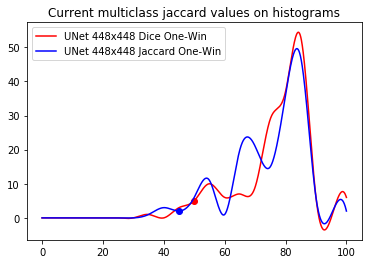

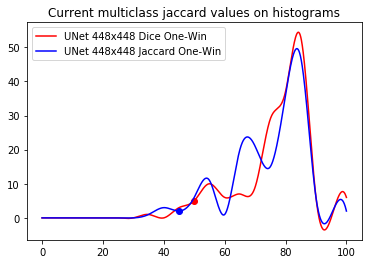

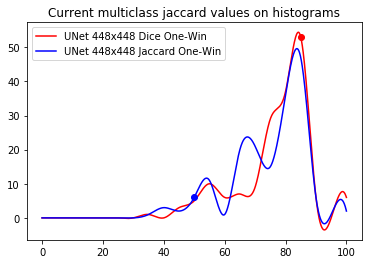

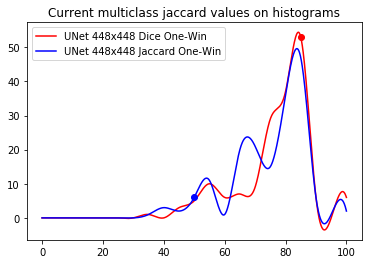

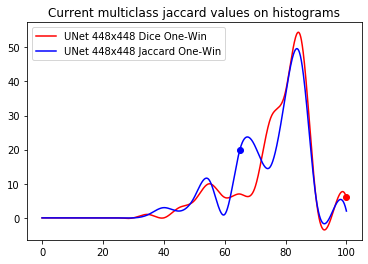

...

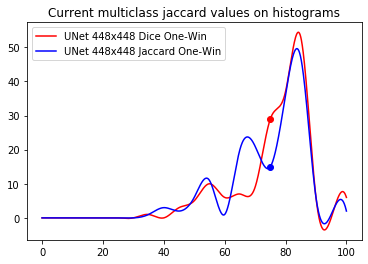

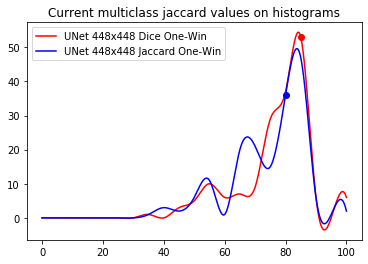

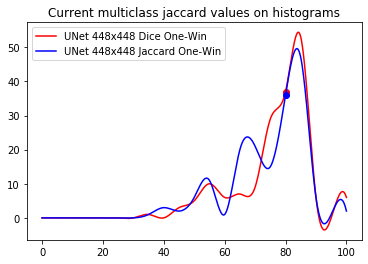

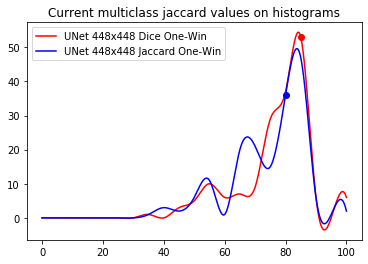

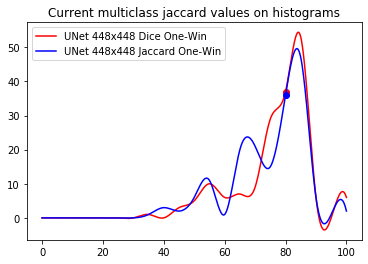

In [4]:
visualize_dir_name = 'onewin_dice_jaccard'
ML_MODELS = [
    UNET_448_OW_DICE,
    UNET_448_OW_JACCARD
]
DATASET_VARIANTS = ['test']
styles = {
    'UNet 448x448 Dice One-Win':    'r',
    'UNet 448x448 Jaccard One-Win': 'b',
}
visualize_diff()

# 448 ONE-WIN DICE vs FULL-SIZE DICE VS FULL-SIZE JACCARD

100%|██████████| 172/172 [00:38<00:00,  4.42it/s]


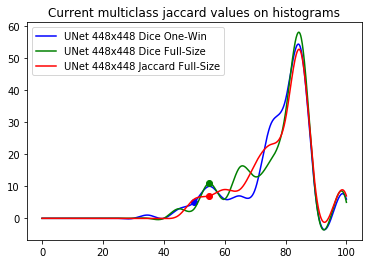

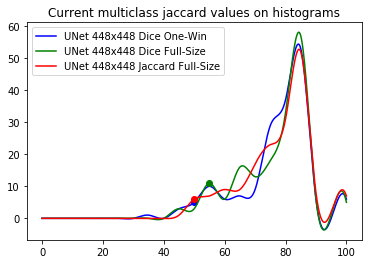

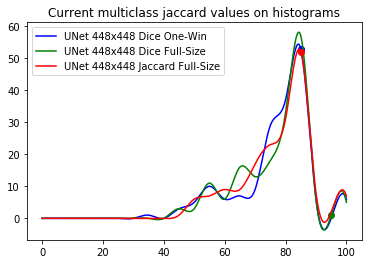

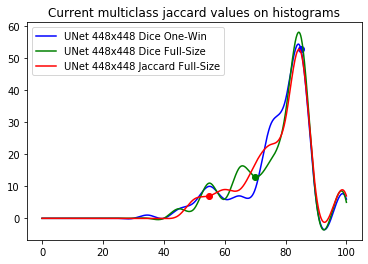

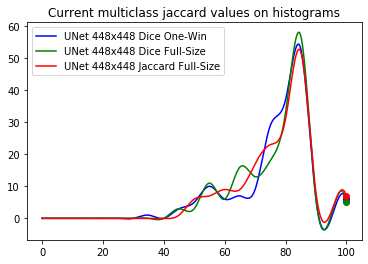

...

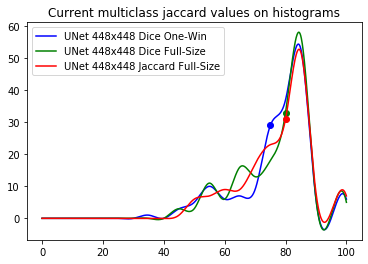

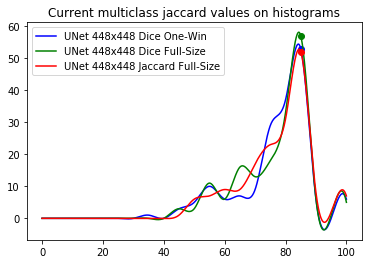

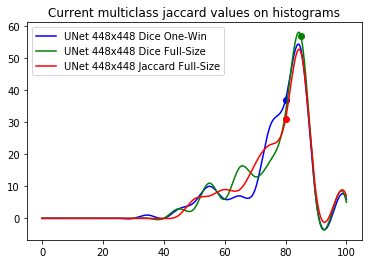

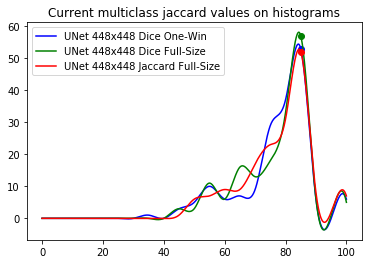

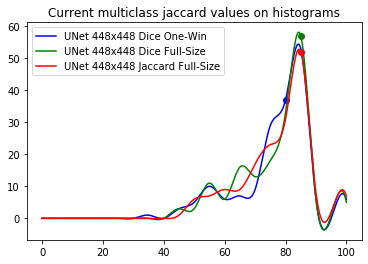

In [5]:
visualize_save_dir_name = 'onewin_fullsize448'
ML_MODELS = [
    UNET_448_OW_DICE,
    UNET_448_FS_DICE,
    UNET_448_FS_JACCARD
]
DATASET_VARIANTS = ['test']
styles = {
    'UNet 448x448 Dice One-Win':        'b',
    'UNet 448x448 Dice Full-Size':      'g',
    'UNet 448x448 Jaccard Full-Size':   'r',
}
visualize_diff()

# 448 FULL-SIZE JACCARD VS 224 FULL-SIZE JACCARD

100%|██████████| 172/172 [00:29<00:00,  5.82it/s]


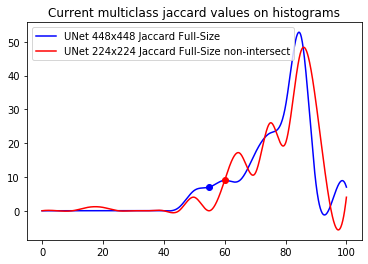

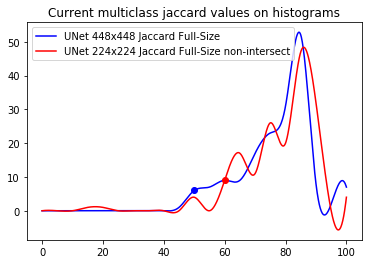

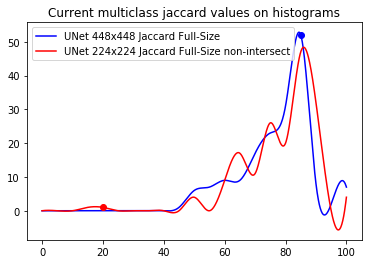

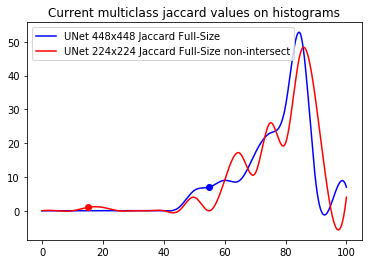

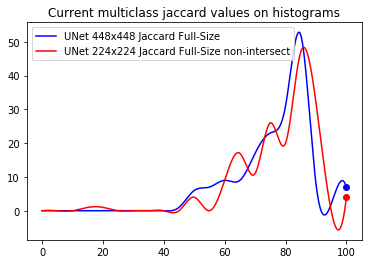

...

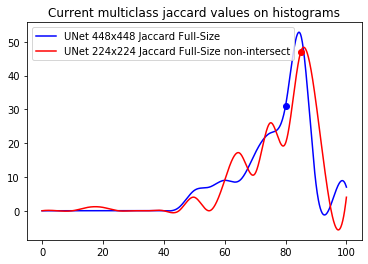

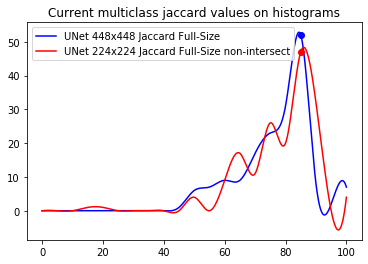

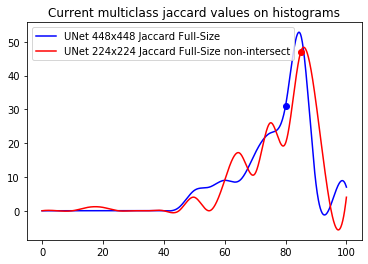

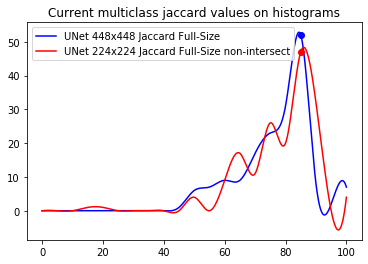

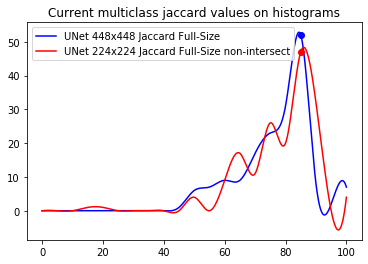

In [6]:
visualize_save_dir_name = 'fullsize448_fullsize224_jaccard'
ML_MODELS = [
    UNET_448_FS_JACCARD,
    UNET_224_FS_JACCARD_NONINT
]
DATASET_VARIANTS = ['test']
styles = {
    'UNet 448x448 Jaccard Full-Size':                'b',
    'UNet 224x224 Jaccard Full-Size non-intersect':  'r',
}
visualize_diff()

# 224 FULL-SIZE JACCARD NON-INT vs ADDW vs GAUSS

100%|██████████| 172/172 [00:37<00:00,  4.63it/s]


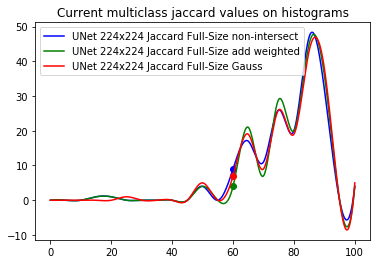

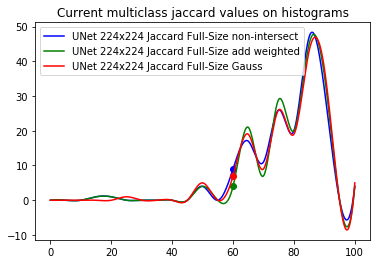

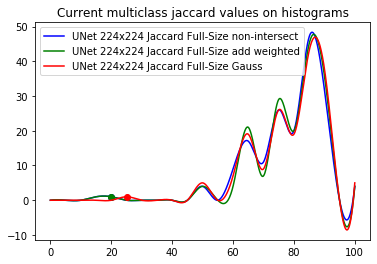

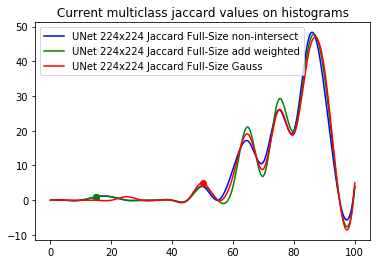

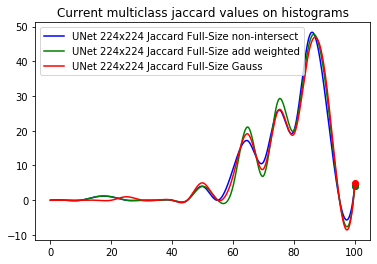

...

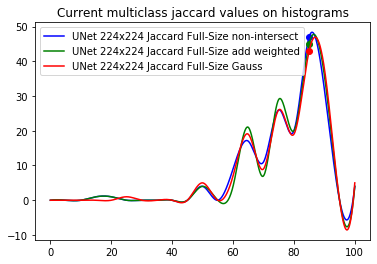

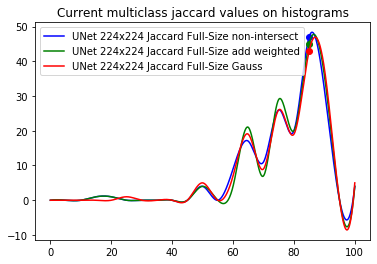

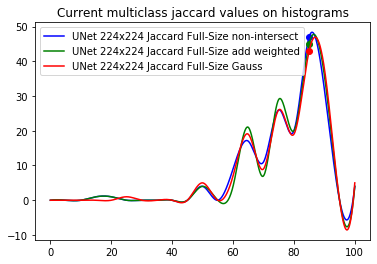

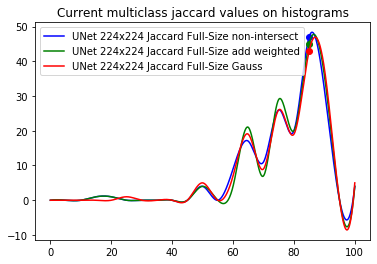

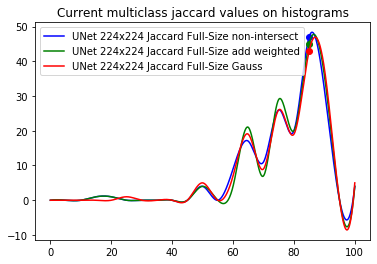

In [7]:
visualize_save_dir_name = 'fullsize224_nonint_addw_gauss'
ML_MODELS = [
    UNET_224_FS_JACCARD_NONINT,
    UNET_224_FS_JACCARD_ADD_WEIGHT,
    UNET_224_FS_JACCARD_GAUSS
]
DATASET_VARIANTS = ['test']
styles = {
    'UNet 224x224 Jaccard Full-Size non-intersect':   'b',
    'UNet 224x224 Jaccard Full-Size add weighted':    'g',
    'UNet 224x224 Jaccard Full-Size Gauss':           'r',
}
visualize_diff()

# 224 FULL-SIZE GAUSS UNET vs UUNET vs WUUNET

100%|██████████| 172/172 [00:37<00:00,  4.62it/s]


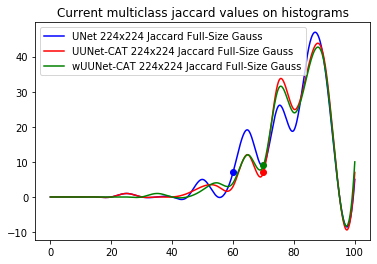

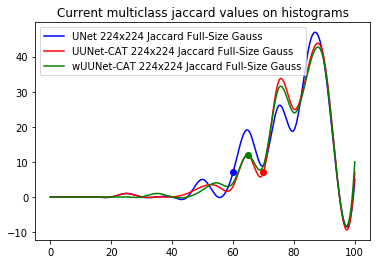

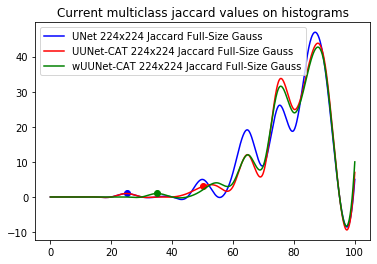

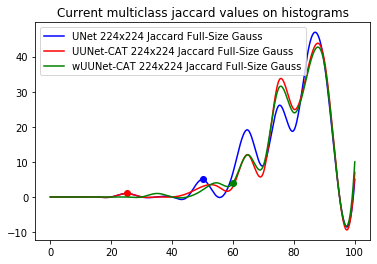

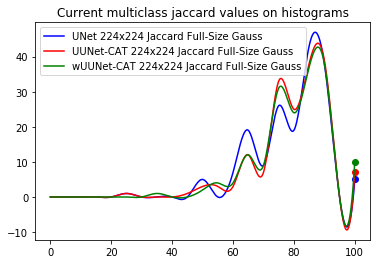

...

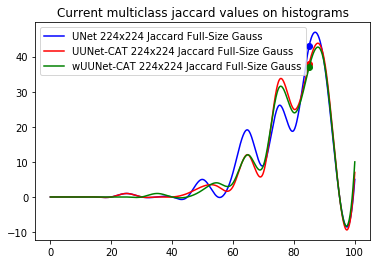

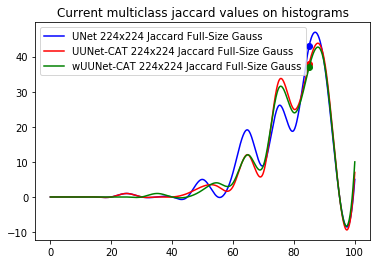

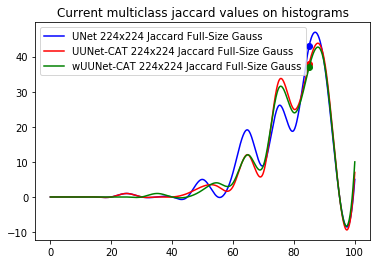

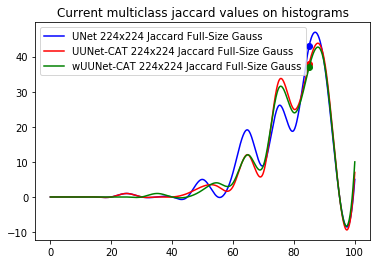

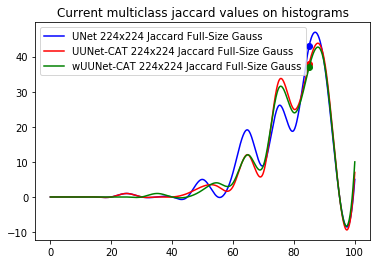

In [8]:
visualize_dir_name = 'unet_uunet_wuunet_gauss_jaccard'
ML_MODELS = [
    UNET_224_FS_JACCARD_GAUSS,
    UUNET_CAT_224_FS_JACCARD_GAUSS,
    WUUNET_CAT_224_FS_JACCARD_GAUSS
]
DATASET_VARIANTS = ['test']
styles = {
    'UNet 224x224 Jaccard Full-Size Gauss':       'b',
    'UUNet-CAT 224x224 Jaccard Full-Size Gauss':  'r',
    'wUUNet-CAT 224x224 Jaccard Full-Size Gauss':  'g',
}

visualize_diff()

# 224 FULL-SIZE GAUSS UUNET vs WUUNET (TRAIN_TEST)

100%|██████████| 414/414 [01:13<00:00,  5.65it/s]


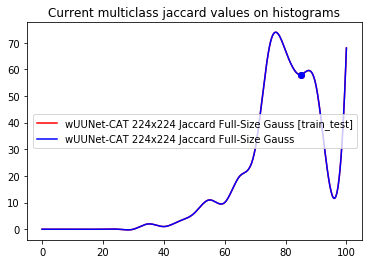

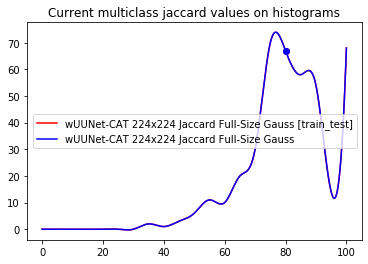

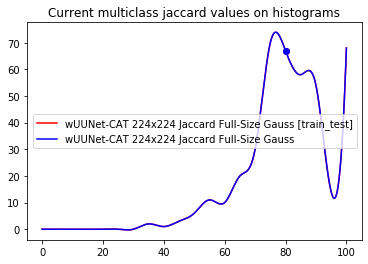

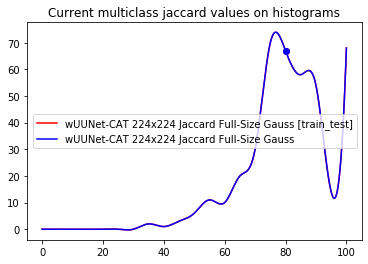

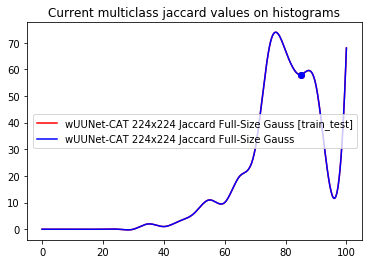

...

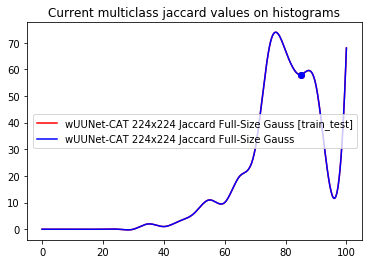

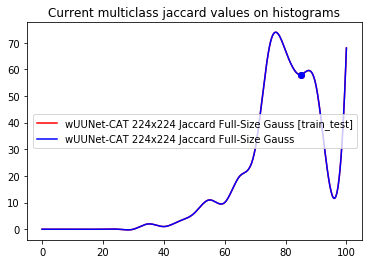

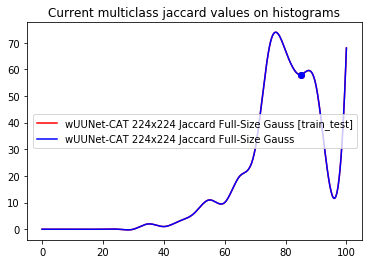

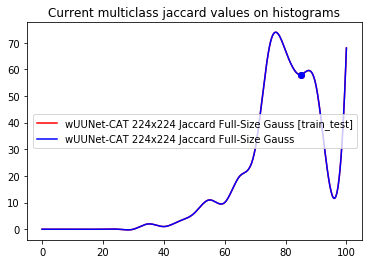

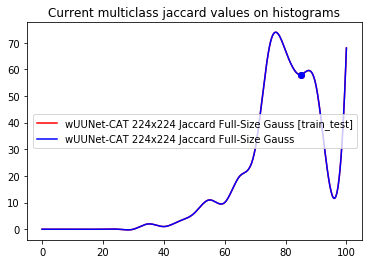

In [9]:
visualize_dir_name = 'wuunet_traintest_gauss_jaccard'
ML_MODELS = [
    WUUNET_CAT_224_FS_JACCARD_GAUSS_TT,
    WUUNET_CAT_224_FS_JACCARD_GAUSS
]
DATASET_VARIANTS = ['train_test']
styles = {
    'wUUNet-CAT 224x224 Jaccard Full-Size Gauss': 'b',
    'wUUNet-CAT 224x224 Jaccard Full-Size Gauss [train_test]': 'r',
}

visualize_diff()

# Visualize wUUNet output for all videos in Dataset and join visualizations together

In [10]:
ML_MODELS = [
   WUUNET_CAT_224_FS_JACCARD_GAUSS,
   WUUNET_CAT_224_FS_JACCARD_GAUSS_TT,
]
VISUALIZE_DIRS = {
   WUUNET_CAT_224_FS_JACCARD_GAUSS:    'wuunet_traintest_gauss_jaccard',
   WUUNET_CAT_224_FS_JACCARD_GAUSS_TT: 'wuunet_traintest_gauss_jaccard'
}

thresholds = {
    ml_model_name + '_' + shapshot_variant: threshold
    for (ml_model_name, shapshot_variant, evaluated_dataset, displayable_model_name, comb_type, threshold, gauss_div) in ML_MODELS
}

DATASET_VARIANTS = ['train_test']

In [26]:
draw_traintest_samples = [
    [0, 8], [0, 6], 
    [21, 0], 
    [22, 4], 
    [1, 8], [1, 6], 
    [23, 0], [23, 8], 
    [10, 12], [10, 38], 
    [25, 2], 
    [2, 2], 
    [3, 0], 
    [4, 8], 
    [26, 0], [26, 2], [26, 4], [26, 6], 
    [27, 6], 
    [5, 0], 
    [6, 6], [6, 10], 
    [7, 0], [7, 8], 
    [28, 4], 
    [8, 2], 
    [29, 2], 
    [9, 6], [9, 8], 
    [10, 16], 
    [31, 4], 
    [11, 2], 
    [26, 18], 
    [23, 6], 
    [14, 0], 
    [15, 6], 
    [26, 10], 
    [17, 6], [17, 22], 
    [18, 2], 
    [19, 4], 
    [20, 0], [20, 2], [20, 8], [20, 10]
]

MAX_I, MAX_J = 9, 5
dsize = 10
ddsize = int(dsize / 2)
overlay = np.ones(((720 + ddsize) * MAX_I + ddsize, (640 + ddsize) * MAX_J + ddsize, 3), dtype=np.uint8) * 0xff
for dataset_variant in DATASET_VARIANTS:
    imgs_path = 'dataset/fs_224/{}/images/'.format(dataset_variant)
    gt_lbls_path = 'dataset/fs_224/{}/labels/'.format(dataset_variant)
    for ml_model in ML_MODELS:
        I, J = 0, 0
        (ml_model_name, snapshot_variant, evaluated_dataset, displayable_model_name, comb_type, threshold, gauss_div) = ml_model
        visualize_dir = 'output/visualization/{}/{}_{}/{}/{}/{}'.format(
                VISUALIZE_DIRS[ml_model], dataset_variant, comb_type, ml_model_name, snapshot_variant, evaluated_dataset)
        sample_num_paths_file = 'output/evaluation/{}_{}/{}/{}/sample_num_paths.json'.format(
            dataset_variant, comb_type, ml_model_name, snapshot_variant)
        sample_num_paths = json.load(open(sample_num_paths_file, 'r'))
        for i, sample_num_path in enumerate(tqdm(sample_num_paths)):
            video_num, sample_num = sample_num_path
            if sample_num_path not in draw_traintest_samples:
                continue
            image_name = imgs_path + '{}/{}.jpg'.format(video_num, sample_num)
            gt_label_name = gt_lbls_path + '{}/{}.npy'.format(video_num, sample_num)
            ground_truth = np.load(gt_label_name)
            ground_truth_oh = get_multiclass_label_map_cuda(ground_truth, 3)
            image = cv2.imread(image_name)
            imh, imw, _ = image.shape
            raw_actual_data_oh_map = {}
            raw_actual_data_oh = np.load('output/evaluation/{}_{}/{}/{}/ad_segmask{}.npy'.format(
                dataset_variant, comb_type, ml_model_name, snapshot_variant, i)
            )
            over = cv2.imread(join(visualize_dir, 'overlay{}.jpg'.format(i)))
            if imh > 360:
                imh = 360
                over = cv2.resize(over, dsize=(imw, imh))
                image = cv2.resize(image, dsize=(imw, imh))
            i0 = I * (2 * imh + ddsize) + ddsize
            j0 = J * (imw + ddsize) + ddsize
            overlay[i0: i0 + imh, j0: j0 + imw] = image.copy()
            overlay[i0 + imh: i0 + imh * 2, j0: j0 + imw] = over.copy()        
            J += 1
            if J == MAX_J:
                J = 0
                I += 1
        cv2.imwrite(join(visualize_dir, 'ALL_IMAGES_OVERLAY1.jpg'), overlay[0: 4 * (2 * imh + ddsize)])
        cv2.imwrite(join(visualize_dir, 'ALL_IMAGES_OVERLAY2.jpg'), overlay[4 * (2 * imh + ddsize):])

100%|██████████| 414/414 [00:00<00:00, 1060.64it/s]
